In [1]:
import pandas as pd

import plotly.express as px
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt


from tqdm.notebook import tqdm
tqdm.pandas()
pd.options.display.max_columns = 999

import plotly.graph_objects as go
import ipyvuetify as v

from ipywidgets import interact, Checkbox, Select, Output, widgets
import ipywidgets
from datetime import datetime

from IPython.display import display


import continental_level_plots
import country_level_plots
import flight_level_plots
import time

In [2]:
#### Import various plot file. In case the source file is modified, please rerun preprocess.py ####

# import preprocess
# preprocess.preprocess()

In [3]:

#read continental level data
continental_flows=pd.read_csv('./plot_files/continental_flows.csv',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)
continental_flows_non_dir=pd.read_csv('./plot_files/continental_flows_non_dir.csv',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)
conti_scatter=pd.read_csv('./plot_files/conti_scatter.csv',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)
flights_df_conti=pd.read_csv('./plot_files/flights_df_conti.zip',compression='zip',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)

#read country level data
country_flows=pd.read_csv('./plot_files/country_flows.csv',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)
country_fixed=pd.read_csv('./plot_files/country_fixed.csv',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)
country_fixed_sep_dom=pd.read_csv('./plot_files/country_fixed_sep_dom.csv',sep=',', keep_default_na=False, na_values=['', 'NaN'], index_col=0)

#read flight_level_data
flights_df=pd.read_csv('./plot_files/flights_df.zip',compression='zip', sep=',',keep_default_na=False, na_values=['', 'NaN'], index_col=0)

In [186]:
##### DEV ZONE ######
world_bank_data= pd.read_csv('data/world_bank_data.csv', sep=';')
countries_fixed_test = country_fixed.merge(world_bank_data, left_on='departure_ISO3', right_on='Country Code', how='left').drop(columns={'Country Name','Country Code'})
countries_fixed_test = countries_fixed_test.dropna(subset=['GDP PPP','toursim_export_share','population'])

countries_fixed_sep_dom_test = country_fixed_sep_dom.merge(world_bank_data, left_on='departure_ISO3', right_on='Country Code', how='left').drop(columns={'Country Name','Country Code'})
countries_fixed_sep_dom_test = countries_fixed_sep_dom_test.dropna(subset=['GDP PPP','Surf','toursim_export_share','population'])


# 1- Flight distance, $CO_2$ emissions and prospects for decarbonization


In this section, AeroSCOPE is use dto evaluate te decarbonization potential of various alternative aircarft types (hydrgen aircraft, electric aircraft) at the global level.  
Then a similar analysis is conducted for two individual countries, Netherlands and Norway.  
_Since switching to hydrogen aviation will require high equipment cost, wee also look at thenumber of airporst to equip??_


* Hydrogen aircraft: <br> The aim of this artcile is not to provide a performance analysis of future hydrogen aircraft concepts. We will rely on Airbus ZeroE targets to define two aicraft nominal range. (https://www.airbus.com/en/innovation/low-carbon-aviation/hydrogen/zeroe)
    - 1000NM : Short range turboprop or fuel cell electric, 100 pax 
    - 2000NM : Short-Medium range turbofan (conventional or blended wing body), 150 pax 

* Battery electric aircraft: <br> hypothesis based on central case of https://www.sciencedirect.com/science/article/pii/S0376042118301179?via%3Dihub
    - 500NM : Ultra short range 180 pax




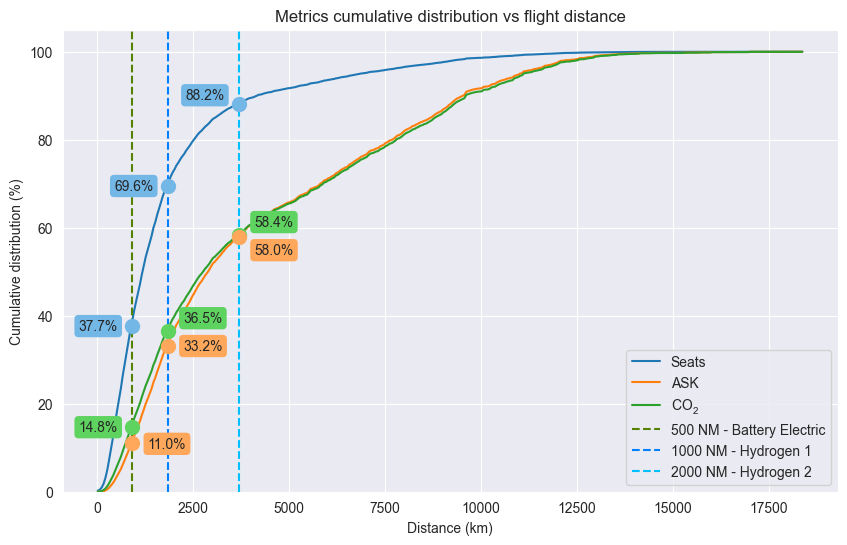

In [5]:
%matplotlib agg

#Directly using AeroSCOPE plot

sns.set_style("darkgrid")
# Create a new figure with a single subplot
fig, ax = plt.subplots(figsize=(10,6))
sns.histplot(flights_df, x='distance_km', weights='seats', label='Seats', element='poly',fill=False, cumulative = True, stat='percent', ax=ax,bins=range(0, int(flights_df["distance_km"].max()) + 50, 50),)
sns.histplot(flights_df, x='distance_km', weights='ask', label= 'ASK', element='poly',fill=False, cumulative = True, stat='percent',ax=ax,bins=range(0, int(flights_df["distance_km"].max()) + 50, 50),)
sns.histplot(flights_df, x='distance_km', weights='co2', label= '$\mathregular{CO_2}$', element='poly',fill=False, cumulative = True, stat='percent', ax=ax,bins=range(0, int(flights_df["distance_km"].max()) + 50, 50),)

ax.legend()

# Set the title, x-axis label, and y-axis label
ax.set_title("Metrics cumulative distribution vs flight distance")
ax.set_xlabel("Distance (km)")
ax.set_ylabel("Cumulative distribution (%)")



# Add vertical lines at 500, 1000, and 2000 NM
ax.axvline(x=500*1.852, color='#568203', linestyle='--', label='500 NM - Battery Electric')
ax.axvline(x=1000*1.852, color='#007FFF', linestyle='--', label='1000 NM - Hydrogen 1 ')
ax.axvline(x=2000*1.852, color='#00BFFF', linestyle='--', label='2000 NM - Hydrogen 2')





# Find the corresponding y-value at the intersection point
y_value = np.interp(500*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['co2'])/sum(flights_df['co2'])*100)
ax.scatter(500*1.852, y_value, marker='o',s=100, zorder=5, color='#5FD35F')
ax.annotate(f'{y_value:.1f}%', xy=(500*1.852-1400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#5FD35F'))

y_value = np.interp(1000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['co2'])/sum(flights_df['co2'])*100)
ax.scatter(1000*1.852, y_value, marker='o',s=100, zorder=5, color='#5FD35F') 
ax.annotate(f'{y_value:.1f}%', xy=(1000*1.852+400, y_value+2),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#5FD35F'))


y_value = np.interp(2000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['co2'])/sum(flights_df['co2'])*100)
ax.scatter(2000*1.852, y_value, marker='o',s=100, zorder=5, color='#5FD35F')  
ax.annotate(f'{y_value:.1f}%', xy=(2000*1.852+400, y_value+2),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#5FD35F'))




# NORWAY 

# Find the corresponding y-value at the intersection point
y_value = np.interp(500*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['seats'])/sum(flights_df['seats'])*100)
ax.scatter(500*1.852, y_value, marker='o',s=100, zorder=5, color='#73B7E7')
ax.annotate(f'{y_value:.1f}%', xy=(500*1.852-1400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#73B7E7'))

y_value = np.interp(1000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['seats'])/sum(flights_df['seats'])*100)
ax.scatter(1000*1.852, y_value, marker='o',s=100, zorder=5, color='#73B7E7') 
ax.annotate(f'{y_value:.1f}%', xy=(1000*1.852-1400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#73B7E7'))


y_value = np.interp(2000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['seats'])/sum(flights_df['seats'])*100)
ax.scatter(2000*1.852, y_value, marker='o',s=100, zorder=5, color='#73B7E7')  
ax.annotate(f'{y_value:.1f}%', xy=(2000*1.852-1400, y_value+1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#73B7E7'))



# NETHERLANDS
# Find the corresponding y-value at the intersection point
y_value = np.interp(500*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['ask'])/sum(flights_df['ask'])*100)
ax.scatter(500*1.852, y_value, marker='o',s=100, zorder=5, color='#FFA85C')
ax.annotate(f'{y_value:.1f}%', xy=(500*1.852+400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#FFA85C'))

y_value = np.interp(1000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['ask'])/sum(flights_df['ask'])*100)
ax.scatter(1000*1.852, y_value, marker='o',s=100, zorder=5, color='#FFA85C') 
ax.annotate(f'{y_value:.1f}%', xy=(1000*1.852+400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#FFA85C'))


y_value = np.interp(2000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['ask'])/sum(flights_df['ask'])*100)
ax.scatter(2000*1.852, y_value, marker='o',s=100, zorder=5, color='#FFA85C')  
ax.annotate(f'{y_value:.1f}%', xy=(2000*1.852+400, y_value-4),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#FFA85C'))



ax.legend()

fig.savefig('metric_repartition.pdf')
fig

As we can see in the plot above, although adressing a substantial share of the journeys, the 500 NM electric aircraft is only able to adress 14.8% of the emissions. 
Please keep in mind that this is only a simplified anlysis. 
Notbaly, two limitations exists:
-  We are not looking at these substitution aircraft performances but only at the potential market size. 
-  The network is not considered. reaching 100% of their potential would likely isolate aircraft on singles routes, which is unrealistic.


Now, we modify AeroMAPS original subplot to explore the potential of alternative aircrfat in two very diffrent european countries: the Netherlands and Norway

In [6]:



flights_NO= flights_df[flights_df['departure_country']=='NO'].reset_index()
flights_NL= flights_df[flights_df['departure_country']=='NL'].reset_index()

sns.set_style("darkgrid")
fig, ax = plt.subplots(figsize=(12,7))
sns.histplot(flights_df, x='distance_km', weights='co2', label='World', element='poly',fill=False,color='#414A4C', cumulative = True, stat='percent', ax=ax,bins=range(0, int(flights_df["distance_km"].max()) + 10, 10),)
sns.histplot(flights_NO, x='distance_km', weights='co2', label= 'Norway', element='poly',fill=False, color='#BA0C2F', cumulative = True, stat='percent',ax=ax,bins=range(0, int(flights_df["distance_km"].max()) + 10, 10),)
sns.histplot(flights_NL, x='distance_km', weights='co2', label= 'Netherlands', element='poly',fill=False,color='#FF9B00', cumulative = True, stat='percent', ax=ax,bins=range(0, int(flights_df["distance_km"].max()) + 10, 10),)

ax.legend()

# Set the title, x-axis label, and y-axis label
ax.set_title("$\mathregular{CO_2}$ cumulative distribution vs flight distance")
ax.set_xlabel("Distance (km)")
ax.set_ylabel("$\mathregular{CO_2}$ cumulative distribution (%)")


# Add vertical lines at 500, 1000, and 2000 NM
ax.axvline(x=500*1.852, color='#568203', linestyle='--', label='500 NM - Battery Electric')
ax.axvline(x=1000*1.852, color='#007FFF', linestyle='--', label='1000 NM - Hydrogen 1 ')
ax.axvline(x=2000*1.852, color='#00BFFF', linestyle='--', label='2000 NM - Hydrogen 2')


# Find the corresponding y-value at the intersection point
y_value = np.interp(500*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['co2'])/sum(flights_df['co2'])*100)
ax.scatter(500*1.852, y_value, marker='o',s=100, zorder=5, color='#414A4C')
ax.annotate(f'{y_value:.1f}%', xy=(500*1.852-1200, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray'))

y_value = np.interp(1000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['co2'])/sum(flights_df['co2'])*100)
ax.scatter(1000*1.852, y_value, marker='o',s=100, zorder=5, color='#414A4C') 
ax.annotate(f'{y_value:.1f}%', xy=(1000*1.852+400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray'))


y_value = np.interp(2000*1.852, flights_df['distance_km'].sort_values(), np.cumsum(flights_df.sort_values(by='distance_km')['co2'])/sum(flights_df['co2'])*100)
ax.scatter(2000*1.852, y_value, marker='o',s=100, zorder=5, color='#414A4C')  
ax.annotate(f'{y_value:.1f}%', xy=(2000*1.852+400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray'))




# NORWAY 

# Find the corresponding y-value at the intersection point
y_value = np.interp(500*1.852, flights_NO['distance_km'].sort_values(), np.cumsum(flights_NO.sort_values(by='distance_km')['co2'])/sum(flights_NO['co2'])*100)
ax.scatter(500*1.852, y_value, marker='o',s=100, zorder=5, color='#BA0C2F')
ax.annotate(f'{y_value:.1f}%', xy=(500*1.852-1200, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#F33F63'))

y_value = np.interp(1000*1.852, flights_NO['distance_km'].sort_values(), np.cumsum(flights_NO.sort_values(by='distance_km')['co2'])/sum(flights_NO['co2'])*100)
ax.scatter(1000*1.852, y_value, marker='o',s=100, zorder=5, color='#BA0C2F') 
ax.annotate(f'{y_value:.1f}%', xy=(1000*1.852-1200, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#F33F63'))


y_value = np.interp(2000*1.852, flights_NO['distance_km'].sort_values(), np.cumsum(flights_NO.sort_values(by='distance_km')['co2'])/sum(flights_NO['co2'])*100)
ax.scatter(2000*1.852, y_value, marker='o',s=100, zorder=5, color='#BA0C2F')  
ax.annotate(f'{y_value:.1f}%', xy=(2000*1.852-1200, y_value+1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#F33F63'))



# NETHERLANDS
# Find the corresponding y-value at the intersection point
y_value = np.interp(500*1.852, flights_NL['distance_km'].sort_values(), np.cumsum(flights_NL.sort_values(by='distance_km')['co2'])/sum(flights_NL['co2'])*100)
ax.scatter(500*1.852, y_value, marker='o',s=100, zorder=5, color='#FF9B00')
ax.annotate(f'{y_value:.1f}%', xy=(500*1.852+400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#FFB647'))

y_value = np.interp(1000*1.852, flights_NL['distance_km'].sort_values(), np.cumsum(flights_NL.sort_values(by='distance_km')['co2'])/sum(flights_NL['co2'])*100)
ax.scatter(1000*1.852, y_value, marker='o',s=100, zorder=5, color='#FF9B00') 
ax.annotate(f'{y_value:.1f}%', xy=(1000*1.852+400, y_value-1),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#FFB647'))


y_value = np.interp(2000*1.852, flights_NL['distance_km'].sort_values(), np.cumsum(flights_NL.sort_values(by='distance_km')['co2'])/sum(flights_NL['co2'])*100)
ax.scatter(2000*1.852, y_value, marker='o',s=100, zorder=5, color='#FF9B00')  
ax.annotate(f'{y_value:.1f}%', xy=(2000*1.852+400, y_value-4),
                bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='#FFB647'))



ax.legend()

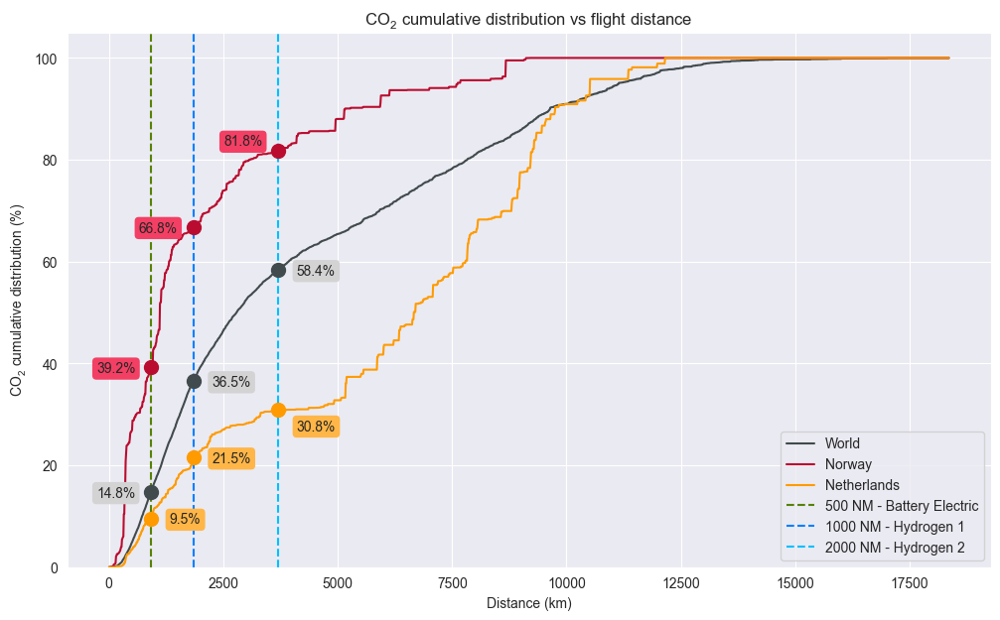

In [7]:
fig.savefig('repartition.pdf')
fig

As we can see in the plot above, Norway is highly dominated by short haul routes, and it would be even more impressive if one used the number of available seats as a metric.   
On the other hand, the netherlands have practically no domestic aviation and Amtsterdam is a major international hub severd by many long haul routes. 

If one is to think about each country decarbonisation plans, this information is very insightfull. In a simplified case where all of these routes would be served by an airline served in this country, Norway could adress 40% of their emissions using an electric aircraft and 82% using hydrogen aircraft, while these values fall to 9.5 and 31% n the second case. 

Once again, the aim of the study is not to focus on the related carbon abatement. 
According to https://app.electricitymaps.com/, the Norwegian electricity emission factor was 35 gCO2/kWh in 2019, while netherlands were producing electricity at 407 gCO2/kWh. This increse the gap highlighted above. Howver, this is of limited interest, and 2030-2050 emissions factors should be considered instead, and that is the focus of AeroMAPS.



In [11]:

##
flights_NL_g = flights_NL.groupby(['iata_departure','iata_arrival']).agg({
    'co2': 'sum',
    'ask': 'sum',
    'seats': 'sum',
    'arrival_lon': 'first',
    'arrival_lat': 'first',
    'departure_lon': 'first',
    'departure_lat': 'first',
    
'distance_km': 'first'}).reset_index()

flights_NL_g.sort_values(by='co2').nlargest(350,columns='co2')['co2'].sum()/flights_NL_g['co2'].sum()
flights_NL_g_top=flights_NL_g#.sort_values(by='co2').nlargest(350,columns='co2').reset_index()



flights_NO_g = flights_NO.groupby(['iata_departure','iata_arrival']).agg({
    'co2': 'sum',
    'ask': 'sum',
    'seats': 'sum',
    'arrival_lon': 'first',
    'arrival_lat': 'first',
    'departure_lon': 'first',
    'departure_lat': 'first',
    
'distance_km': 'first'}).reset_index()

flights_NO_g.sort_values(by='co2').nlargest(350,columns='co2')['co2'].sum()/flights_NO_g['co2'].sum()
flights_NO_g_top=flights_NO_g#.sort_values(by='co2').nlargest(350,columns='co2').reset_index()


fl_g=pd.concat([flights_NL_g, flights_NO_g])

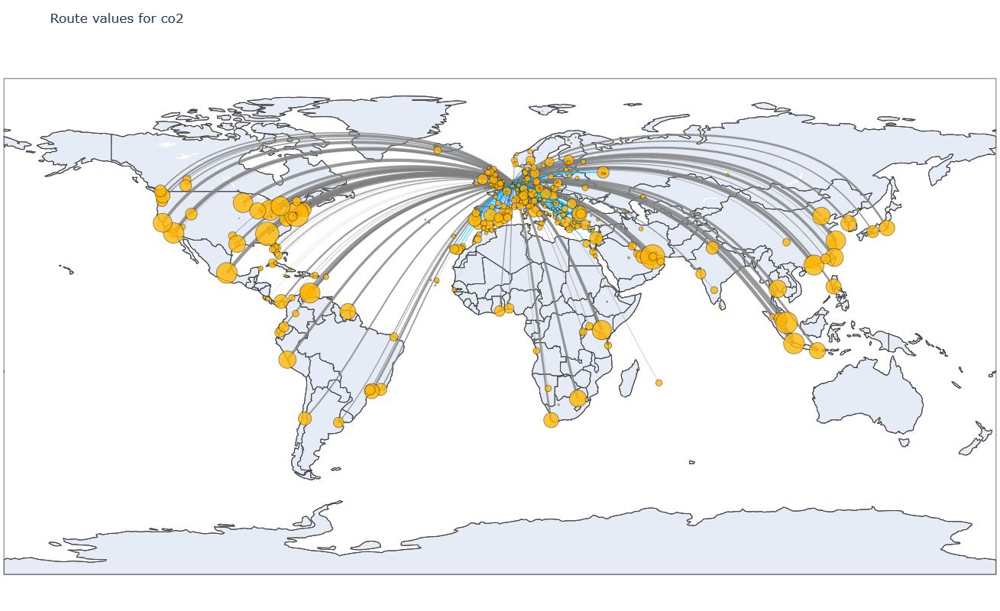

In [14]:



flights_NL_g_top['color']='gray'


def color_picker(d):
    d=d/1.852
    if d<500:
        color='#568203'
        # color=f'rgba(0,0,0,0)'
    elif 500<=d<1000:
        color='#007FFF'
        # color=f'rgba(0,0,0,0)'
    elif 1000<=d<2000:
        color='#00BFFF'
        # color=f'rgba(0,0,0,0)'
    else:
        color='gray'
        # color=f'rgba(0,0,0,0)'
    return color
    

flights_NL_g_top['color']=flights_NL_g_top.apply(lambda x: color_picker(x['distance_km']), axis=1)




value_watched_flights='co2'
flights_gpb_df=flights_NL_g_top

# Create the scattergeo figure
fig = go.Figure()

meanwidth = flights_gpb_df[value_watched_flights].mean()

for i in range(len(flights_gpb_df)):
    fig.add_trace(
        go.Scattergeo(
            lon=[flights_gpb_df['departure_lon'][i], flights_gpb_df['arrival_lon'][i]],
            lat=[flights_gpb_df['departure_lat'][i], flights_gpb_df['arrival_lat'][i]],
            mode='lines',
            line=dict(width=flights_gpb_df[value_watched_flights][i] / (3*meanwidth), color=flights_gpb_df['color'][i]),
            opacity=0.8
        )
    )

# group by airport

airport_df = flights_gpb_df.groupby('iata_arrival').agg({
    'co2': 'sum',
    'ask': 'sum',
    'seats': 'sum',
    'arrival_lon': 'first',
    'arrival_lat': 'first'}).reset_index()

fig.add_trace(go.Scattergeo(
    lon=airport_df['arrival_lon'],
    lat=airport_df['arrival_lat'],
    hoverinfo='text',
    text=airport_df[value_watched_flights],
    mode='markers',
    marker=dict(
        size=airport_df[value_watched_flights] / (.07 * fl_g[value_watched_flights].mean()),
        color='#ffb703',
        sizemode='area',
        opacity=0.8,
        line=dict(width=0.5, color='black'),
    ),
    customdata=airport_df['iata_arrival'],
    hovertemplate="Flights to: " + "%{customdata}<br>" +
                  value_watched_flights + ": %{text:.0f}<br>" +
                  "<extra></extra>",

))


fig.update_geos(showcountries=True)
fig.update_layout(showlegend=False, height=800, title='Route values for {}'.format(value_watched_flights))
fig.update_layout(margin=dict(l=5, r=5, t=60, b=5))  # Adjust layout margins and padding


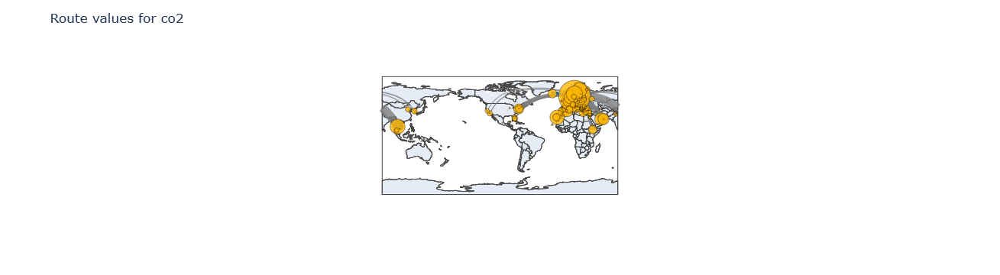

In [13]:


flights_NO_g_top['color']='gray'


def color_picker(d):
    d=d/1.852
    if d<500:
        color='#568203'
        # color=f'rgba(0,0,0,0)'
    elif 500<=d<1000:
        color='#007FFF'
        # color=f'rgba(0,0,0,0)'
    elif 1000<=d<2000:
        color='#00BFFF'
        # color=f'rgba(0,0,0,0)'
    else:
        color='gray'
        # color=f'rgba(0,0,0,0)'
    return color
    

flights_NO_g_top['color']=flights_NO_g_top.apply(lambda x: color_picker(x['distance_km']), axis=1)




value_watched_flights='co2'
flights_gpb_df=flights_NO_g_top

# Create the scattergeo figure
fig = go.Figure()

meanwidth = flights_gpb_df[value_watched_flights].mean()

for i in range(len(flights_gpb_df)):
    fig.add_trace(
        go.Scattergeo(
            lon=[flights_gpb_df['departure_lon'][i], flights_gpb_df['arrival_lon'][i]],
            lat=[flights_gpb_df['departure_lat'][i], flights_gpb_df['arrival_lat'][i]],
            mode='lines',
            line=dict(width=flights_gpb_df[value_watched_flights][i] / (3*meanwidth), color=flights_gpb_df['color'][i]),
            opacity=0.8
        )
    )

# group by airport

airport_df = flights_gpb_df.groupby('iata_arrival').agg({
    'co2': 'sum',
    'ask': 'sum',
    'seats': 'sum',
    'arrival_lon': 'first',
    'arrival_lat': 'first'}).reset_index()

fig.add_trace(go.Scattergeo(
    lon=airport_df['arrival_lon'],
    lat=airport_df['arrival_lat'],
    hoverinfo='text',
    text=airport_df[value_watched_flights],
    mode='markers',
    marker=dict(
        size=airport_df[value_watched_flights] / (.07 * fl_g[value_watched_flights].mean()),
        color='#ffb703',
        sizemode='area',
        opacity=0.8,
        line=dict(width=0.5, color='black'),
    ),
    customdata=airport_df['iata_arrival'],
    hovertemplate="Flights to: " + "%{customdata}<br>" +
                  value_watched_flights + ": %{text:.0f}<br>" +
                  "<extra></extra>",

))


fig.update_geos(showcountries=True)
fig.update_layout(showlegend=False, height=800, title='Route values for {}'.format(value_watched_flights))
fig.update_layout(margin=dict(l=5, r=5, t=60, b=5))  # Adjust layout margins and padding

In [28]:
flights_df_gp= flights_df.groupby(['iata_departure','iata_arrival']).agg({
    'co2': 'sum',
    'ask': 'sum',
    'seats': 'sum',
    'arrival_lon': 'first',
    'arrival_lat': 'first',
    'departure_lon': 'first',
    'departure_lat': 'first',
    
'distance_km': 'first'}).reset_index()


flights_df_gp_elec=flights_df_gp[flights_df_gp.distance_km<500*1.852]

flights_df_gp_h2=flights_df_gp[(flights_df_gp.distance_km>=500*1.852) & (flights_df_gp.distance_km<1000*1.852)]

flights_df_gp_h2_bis=flights_df_gp[(flights_df_gp.distance_km>=500*1.852) & (flights_df_gp.distance_km<2000*1.852)]

In [176]:
flights_df_gp_elec
flights_df_gp_elec.sort_values(by='co2').nlargest(5000,columns='co2')['co2'].sum()/flights_df_gp_elec['co2'].sum()
flights_df_gp_elec_top=flights_df_gp_elec.sort_values(by='co2').nlargest(5000,columns='co2').reset_index()

In [137]:


def is_in_top(ap, top):
    if ap in top:
        return 1
    else:
        
        return 0

score=[]

for i in range (0,8000,500):
    top500_elec=flights_df_gp_elec.groupby('iata_departure')['co2'].sum().nlargest(i).index.to_list()
    flights_df_gp_elec['top_departure'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_departure'], top500_elec),axis=1)
    flights_df_gp_elec['top_arrival'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_arrival'], top500_elec),axis=1)
    
    score.append(flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)]['co2'].sum()/flights_df_gp_elec['co2'].sum())
    
    

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1117798024.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1117798024.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1117798024.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in

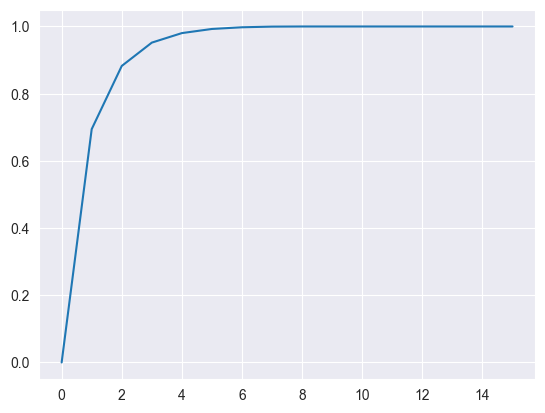

In [139]:
%matplotlib inline
plt.plot(score)

In [174]:
flights_df_gp_elec.groupby('iata_departure')['co2'].sum()

iata_departure
05A    6.800142e+03
06A    4.046270e+02
09A    2.504616e+03
1B1    1.661890e+03
1CA    1.535872e+03
           ...     
ZXM    1.665548e+04
ZXN    6.719751e+03
ZXU    4.980236e+03
ZYI    5.991305e+07
ZYL    9.502436e+06
Name: co2, Length: 4411, dtype: float64

In [170]:
top500_elec=flights_df_gp_elec.groupby('iata_departure')['co2'].sum().nlargest(500).index.to_list()
flights_df_gp_elec['top_departure'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_departure'], top500_elec),axis=1)
flights_df_gp_elec['top_arrival'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_arrival'], top500_elec),axis=1)

testo=flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)].reset_index()
flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)]['co2'].sum()/flights_df_gp_elec['co2'].sum()

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1329821636.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1329821636.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0.694468777452973

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1508356426.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1508356426.py:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1508356426.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in

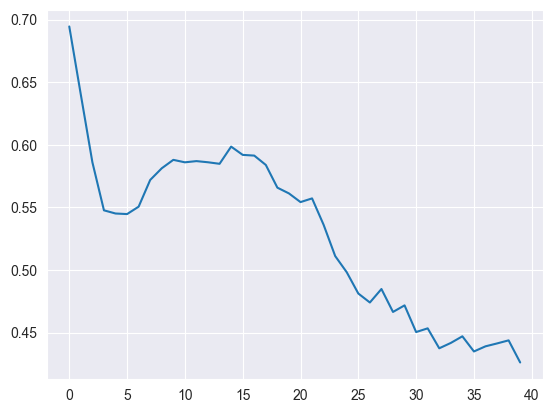

In [154]:



def smart_top(top, df, nmax,j):
    i=0
    count=0
    while count<nmax:
        ap=top[i]
        top_list.append(ap)
        count+=1
        destinations=df[df.iata_departure==ap].groupby('iata_arrival')['co2'].sum().nlargest(j).index.to_list()
        for el in destinations:
            if el not in top_list:
                top_list.append(el)
                count+=1
        i+=1
    return top_list

score_2=[]
for j in range (0,40):
    top_list=[]
    top_list=smart_top(top500_elec, flights_df_gp_elec.reset_index(), 500, j)

    flights_df_gp_elec['top_departure'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_departure'], top_list),axis=1)
    flights_df_gp_elec['top_arrival'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_arrival'], top_list),axis=1)

    testo=flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)].reset_index()
    score_2.append(flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)]['co2'].sum()/flights_df_gp_elec['co2'].sum())
    

plt.plot(score_2)

In [161]:
flights_df_gp_elec_top

,index,iata_departure,iata_arrival,co2,ask,seats,arrival_lon,arrival_lat,departure_lon,departure_lat,distance_km,top_departure,top_arrival
0,27109,DEL,AMD,4.613072e+08,4.834521e+09,6.413983e+06,72.634697,23.077200,77.095190,28.555630,753.747168,1,1
1,3696,AMD,DEL,4.613072e+08,4.834521e+09,6.413983e+06,77.095190,28.555630,72.634697,23.077200,753.747168,1,1
2,67197,MEL,SYD,3.728672e+08,3.803354e+09,5.387742e+06,151.177002,-33.946098,144.843002,-37.673302,705.927225,1,1
3,100128,SYD,MEL,3.728672e+08,3.803354e+09,5.387742e+06,144.843002,-37.673302,151.177002,-33.946098,705.927225,1,1
4,24879,CTS,HND,2.860086e+08,3.095906e+09,3.781668e+06,139.779999,35.552299,141.692001,42.775200,818.661525,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
11295,18323,CBH,ALG,1.503270e+06,1.575811e+07,2.089394e+04,3.214531,36.693886,-2.269860,31.645700,754.195161,0,1
11296,75311,NNY,NGB,1.503214e+06,1.691452e+07,1.857573e+04,121.461998,29.826700,112.617467,32.982696,910.571113,1,0
11297,74580,NGB,NNY,1.503214e+06,1.691452e+07,1.857573e+04,112.617467,32.982696,121.461998,29.826700,910.571113,0,1
11298,30835,DUS,EDI,1.503192e+06,1.925092e+07,2.273769e+04,-3.372288,55.950145,6.766780,51.289501,846.652211,1,1


C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1303334632.py:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1303334632.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\Temp\ipykernel_11488\1303334632.py:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in

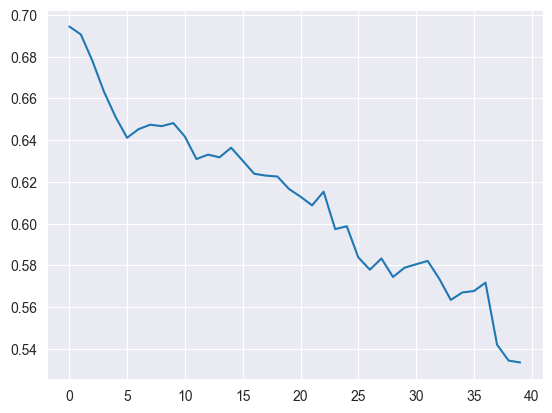

In [177]:
def smart_top(top, df, df_routes_top, nmax, j):
    i=0
    count=0
    while count<nmax:
        ap=top[i]
        if ap not in top_list:
            top_list.append(ap)
            count+=1
        destinations=df_routes_top[df_routes_top.iata_departure==ap].groupby('iata_arrival')['co2'].sum().nlargest(j).index.to_list()
        for el in destinations:
            if el not in top_list:
                top_list.append(el)
                count+=1
        i+=1
    return top_list

score_2=[]
for j in range (0,40):
    top_list=[]
    top_list=smart_top(top500_elec, flights_df_gp_elec.reset_index(), flights_df_gp_elec_top.reset_index(), 500, j)

    flights_df_gp_elec['top_departure'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_departure'], top_list),axis=1)
    flights_df_gp_elec['top_arrival'] = flights_df_gp_elec.apply(lambda x: is_in_top(x['iata_arrival'], top_list),axis=1)

    testo=flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)].reset_index()
    score_2.append(flights_df_gp_elec[(flights_df_gp_elec.top_arrival==1)&(flights_df_gp_elec.top_departure==1)]['co2'].sum()/flights_df_gp_elec['co2'].sum())
    

plt.plot(score_2)

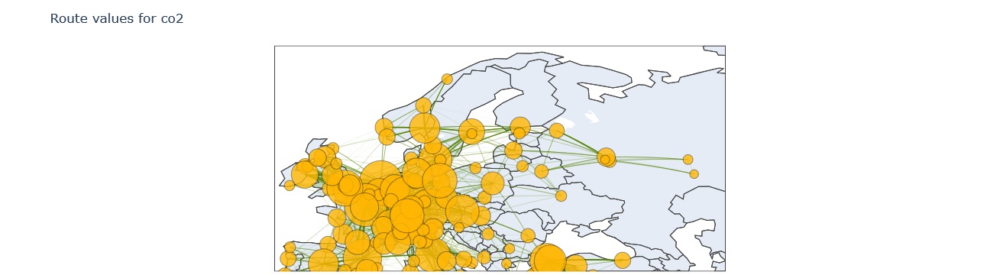

In [171]:
testo['color']='gray'


def color_picker(d):
    d=d/1.852
    if d<500:
        color='#568203'
        # color=f'rgba(0,0,0,0)'
    elif 500<=d<1000:
        color='#007FFF'
        # color=f'rgba(0,0,0,0)'
    elif 1000<=d<2000:
        color='#00BFFF'
        # color=f'rgba(0,0,0,0)'
    else:
        color='gray'
        # color=f'rgba(0,0,0,0)'
    return color
    

testo['color']=testo.apply(lambda x: color_picker(x['distance_km']), axis=1)




value_watched_flights='co2'
flights_gpb_df=testo

# Create the scattergeo figure
fig = go.Figure()

meanwidth = flights_gpb_df[value_watched_flights].mean()

for i in range(len(flights_gpb_df)):
    fig.add_trace(
        go.Scattergeo(
            lon=[flights_gpb_df['departure_lon'][i], flights_gpb_df['arrival_lon'][i]],
            lat=[flights_gpb_df['departure_lat'][i], flights_gpb_df['arrival_lat'][i]],
            mode='lines',
            line=dict(width=flights_gpb_df[value_watched_flights][i] / (3*meanwidth), color=flights_gpb_df['color'][i]),
            opacity=0.8
        )
    )

# group by airport

airport_df = flights_gpb_df.groupby('iata_arrival').agg({
    'co2': 'sum',
    'ask': 'sum',
    'seats': 'sum',
    'arrival_lon': 'first',
    'arrival_lat': 'first'}).reset_index()

fig.add_trace(go.Scattergeo(
    lon=airport_df['arrival_lon'],
    lat=airport_df['arrival_lat'],
    hoverinfo='text',
    text=airport_df[value_watched_flights],
    mode='markers',
    marker=dict(
        size=airport_df[value_watched_flights] / (.07 * fl_g[value_watched_flights].mean()),
        color='#ffb703',
        sizemode='area',
        opacity=0.8,
        line=dict(width=0.5, color='black'),
    ),
    customdata=airport_df['iata_arrival'],
    hovertemplate="Flights to: " + "%{customdata}<br>" +
                  value_watched_flights + ": %{text:.0f}<br>" +
                  "<extra></extra>",

))


fig.update_geos(showcountries=True)
fig.update_layout(showlegend=False, height=800, title='Route values for {}'.format(value_watched_flights))
fig.update_layout(margin=dict(l=5, r=5, t=60, b=5))  # Adjust layout margins and padding

# 2- RPK/inhabitant and inequal traffic repartition

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import (
    mean_absolute_error,
    mean_squared_error,
    median_absolute_error,
    mean_absolute_percentage_error,
    r2_score,
)


0.8428296033232665
[0.00000000e+00 3.01277757e-05 4.44629246e-10]


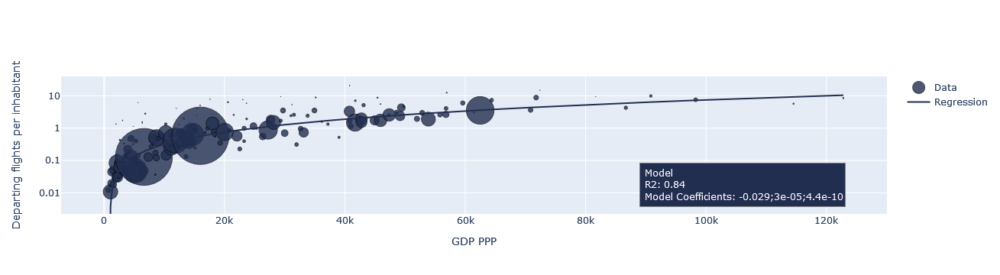

In [7]:
### Polynomial regression

X = countries_fixed_test[['GDP PPP']].copy()
y = (countries_fixed_test['seats']/countries_fixed_test['population'])

##### Polynomial #####
w=countries_fixed_test['population']


# # Create polynomial features
poly_features = PolynomialFeatures(degree=2)
X_poly = poly_features.fit_transform(X)

# # Fit the polynomial regression model
model = LinearRegression()
model.fit(X_poly, y, sample_weight=w)

# Generate predictions
y_pred = model.predict(X_poly)



df_viz = pd.concat([X,countries_fixed_test[['departure_country_name', 'population']], y], axis=1).rename(columns={0:'y'})
df_viz['y_pred']=y_pred


df_viz=df_viz.sort_values(by='GDP PPP')

fig = go.Figure()

# Add a scatter plot
fig.add_trace(go.Scatter(
    x=df_viz['GDP PPP'],
    y=df_viz['y'],
    mode='markers',
    marker=dict(
        size=0.000002*df_viz['population'],
        opacity=0.8 , # Set the marker opacity,
        sizemode='area', 
        color="#222E50",
        line=dict(color='#0c111d'),
    ),
    text=df_viz['departure_country_name'],
    name='Data'
))
# fig= go.Figure()



fig.add_trace(go.Scatter(
    y=df_viz['y_pred'].values,
    x=df_viz['GDP PPP'].values,
    opacity=1,
    line=dict(color='#222E50'),
    name='Regression'
))


fig.update_layout(
    height=800,
        xaxis_title='GDP PPP',
        yaxis_title='Departing flights per inhabitant',
        yaxis_type='log'
    
)

r2 = r2_score(y, y_pred, sample_weight=w)

fig.add_annotation(
    text=f'Model<br>R2: {r2:.2f}<br>Model Coefficients: {model.intercept_:.2};{model.coef_[1]:.2};{model.coef_[2]:.2}',
    showarrow=False,
    xref='paper',
    yref='paper',
    x=0.95,
    y=0.05,
    font=dict(size=12, color='white'),  # Text style
    align='left',
    bgcolor='rgb(34, 46, 80, 0.25)',  # Box background color
    bordercolor='gray',  # Box border color
    borderwidth=1,  # Box border width
    borderpad=4,
)


r2 = r2_score(y, y_pred, sample_weight=w)
print(r2)
print(model.coef_)
fig

In [8]:
country_int

NameError: name 'country_int' is not defined

0.8719394350723524
[ 0.00000000e+00  2.28742965e-05  1.75902598e-02  4.14354522e-10
  1.09761945e-06 -3.52161659e-04]


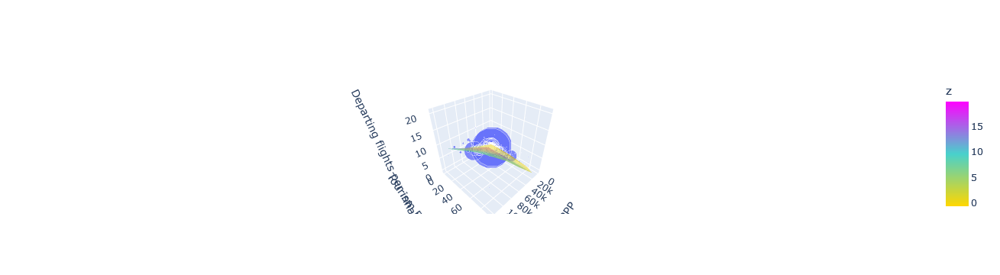

In [9]:
### Multipolynomial regression by adding the toursim export share
# ==> very limited improvement of the fit



X = countries_fixed_test[['GDP PPP', 'toursim_export_share']].copy()
y = (countries_fixed_test['seats']/countries_fixed_test['population'])

##### Polynomial #####
w=countries_fixed_test['population']


# # Create polynomial features
poly_features = PolynomialFeatures(degree=2)
X_poly = poly_features.fit_transform(X)

# # Fit the polynomial regression model
model = LinearRegression()
model.fit(X_poly, y, sample_weight=w)

# Generate predictions
y_pred = model.predict(X_poly)



df_viz = pd.concat([X,countries_fixed_test[['departure_country_name', 'population']], y], axis=1).rename(columns={0:'y'})
df_viz['y_pred']=y_pred


df_viz=df_viz.sort_values(by='GDP PPP')

fig = go.Figure()

# Add a scatter plot
fig.add_trace(go.Scatter3d(
    x=df_viz['GDP PPP'],
    y=df_viz['toursim_export_share'],
    z=df_viz['y'],
    mode='markers',
    marker=dict(
        size=0.000005*df_viz['population'],
        opacity=0.8,  # Set the marker opacity
        sizemode='area',
    ),
    text=df_viz['departure_country_name'],
))
# fig= go.Figure()



fig.add_trace(go.Mesh3d(
    z=df_viz['y_pred'].values,
    intensity=df_viz['y_pred'].values,
    x=df_viz['GDP PPP'].values,
    y=df_viz['toursim_export_share'].values,
    opacity=0.5,
    colorbar_title='z',
        colorscale=[[0, 'gold'],
                    [0.5, 'mediumturquoise'],
                    [1, 'magenta']],
    
    # log_y=True, 
    # mode='lines',
))


fig.update_layout(
    height=1200,
    scene=dict(
        xaxis_title='GDP PPP',
        yaxis_title='Tourism Export Share',
        zaxis_title='Departing flights per inhabitant',
        # zaxis_type='log'
    )
)


r2 = r2_score(y, y_pred, sample_weight=w)
print(r2)
print(model.coef_)
fig

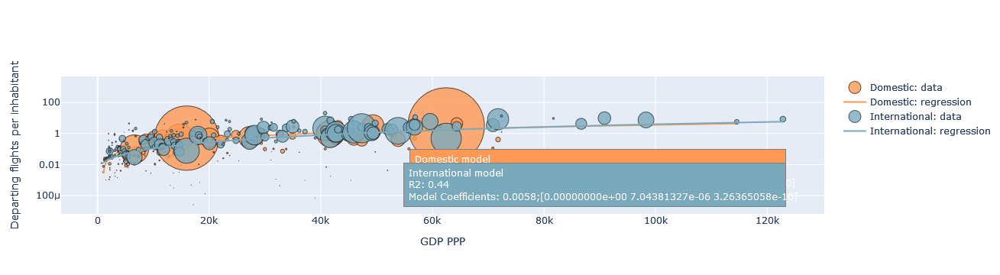

In [10]:
### Polynomial regression


country_dom=countries_fixed_sep_dom_test[countries_fixed_sep_dom_test['domestic']==1 ].copy()
country_dom=country_dom[country_dom['seats']/country_dom['population']>0.00]


X = country_dom[['GDP PPP']].copy()
y = (country_dom['seats']/country_dom['population'])

##### Polynomial #####
w=country_dom['population']


# # Create polynomial features
poly_features = PolynomialFeatures(degree=2)
X_poly = poly_features.fit_transform(X)

# # Fit the polynomial regression model
model = LinearRegression()
model.fit(X_poly, y, sample_weight=w)

# Generate predictions
y_pred = model.predict(X_poly)



df_viz = pd.concat([X,country_dom[['departure_country_name', 'population', 'seats']], y], axis=1).rename(columns={0:'y'})
df_viz['y_pred']=y_pred


df_viz=df_viz.sort_values(by='GDP PPP')

fig = go.Figure()

# Add a scatter plot
fig.add_trace(go.Scatter(
    x=df_viz['GDP PPP'],
    y=df_viz['y'],
    mode='markers',
    marker=dict(
        size=0.000005*df_viz['seats'],
        opacity=0.8 , # Set the marker opacity,
        color='rgb(255, 153, 85)',
        sizemode='area',
        line=dict(color='#3D1800')
    ),
    text=df_viz['departure_country_name'],
    name='Domestic: data'
))
# fig= go.Figure()



fig.add_trace(go.Scatter(
    y=df_viz['y_pred'].values,
    x=df_viz['GDP PPP'].values,
    opacity=1,
    line=dict(color='rgb(255, 153, 85)'),
    name='Domestic: regression'
))


r2 = r2_score(y, y_pred, sample_weight=w)


fig.add_annotation(
    text=f'Domestic model<br>R2: {r2:.2f}<br>Model Coefficients: {model.intercept_:.2};{model.coef_}',
    showarrow=False,
    xref='paper',
    yref='paper',
    x=0.95,
    y=0.15,
    font=dict(size=12, color='white'),  # Text style
    align='left',
    bgcolor='rgb(255, 153, 85, 0.25)',  # Box background color
    bordercolor='gray',  # Box border color
    borderwidth=1,  # Box border width
    borderpad=4,
)

##################### DOMESTIC #########################################
country_int=countries_fixed_sep_dom_test[countries_fixed_sep_dom_test['domestic']==0].copy()
country_int=country_int[country_int['seats']/country_int['population']>0.00]


### Polynomial regression

X = country_int[['GDP PPP']].copy()
y = (country_int['seats']/country_int['population'])

##### Polynomial #####
w=country_int['population']


# # Create polynomial features
poly_features = PolynomialFeatures(degree=2)
X_poly = poly_features.fit_transform(X)

# # Fit the polynomial regression model
model = LinearRegression()
model.fit(X_poly, y, sample_weight=w)

# Generate predictions
y_pred = model.predict(X_poly)



df_viz = pd.concat([X,country_int[['departure_country_name', 'population', 'seats']], y], axis=1).rename(columns={0:'y'})
df_viz['y_pred']=y_pred


df_viz=df_viz.sort_values(by='GDP PPP')


# Add a scatter plot
fig.add_trace(go.Scatter(
    x=df_viz['GDP PPP'],
    y=df_viz['y'],
    mode='markers',
    marker=dict(
        size=0.000005*df_viz['seats'],
        opacity=0.8 , # Set the marker opacity,
        sizemode='area',
        color='rgb(123, 169, 188)', 
        line=dict(color='#1B2E36')
    ),
    text=df_viz['departure_country_name'],
    name='International: data'
))
# fig= go.Figure()



fig.add_trace(go.Scatter(
    y=df_viz['y_pred'].values,
    x=df_viz['GDP PPP'].values,
    opacity=1,
    line=dict(color='rgb(123, 169, 188)'),
    name='International: regression'
))


fig.update_layout(
    height=800,
        xaxis_title='GDP PPP',
        yaxis_title='Departing flights per inhabitant',
        yaxis_type='log',
        # yaxis=dict(range=[1, None])
    
)

r2 = r2_score(y, y_pred, sample_weight=w)

fig.add_annotation(
    text=f'International model<br>R2: {r2:.2f}<br>Model Coefficients: {model.intercept_:.2};{model.coef_}',
    showarrow=False,
    xref='paper',
    yref='paper',
    x=0.95,
    y=0.05,
    font=dict(size=12, color='white'),  # Text style
    align='left',
    bgcolor='rgb(123, 169, 188, 0.25)',  # Box background color
    bordercolor='gray',  # Box border color
    borderwidth=1,  # Box border width
    borderpad=4,
)

fig

In [187]:
countries_fixed_test = country_fixed.merge(world_bank_data, left_on='departure_ISO3', right_on='Country Code', how='left').drop(columns={'Country Name','Country Code'})
# countries_fixed_test = countries_fixed_test.dropna(subset=['population'])

In [189]:
countries_fixed_test[countries_fixed_test.population.isna()]['departure_ISO3']

67     FLK
188    SHN
Name: departure_ISO3, dtype: object

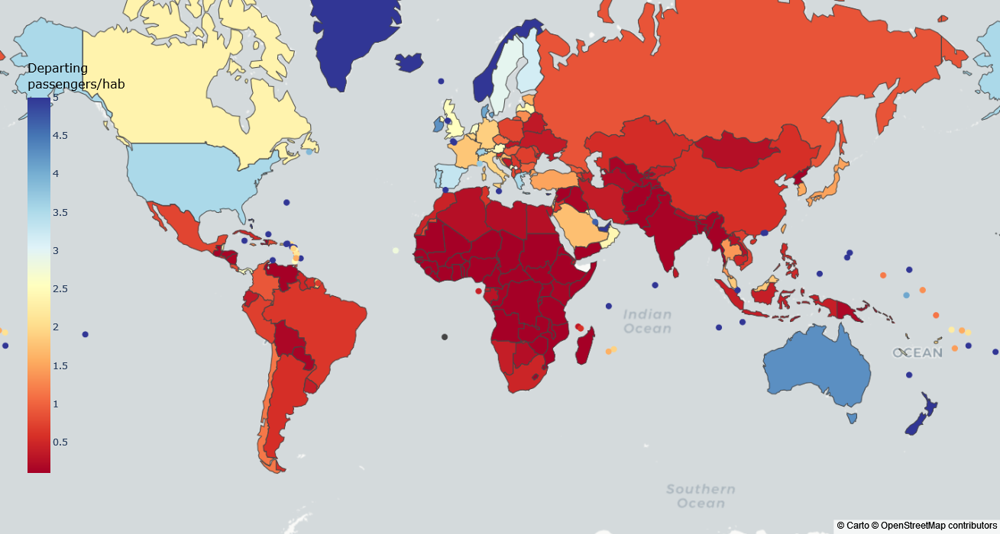

In [190]:
countries_fixed_test['seathab']=countries_fixed_test['seats']/countries_fixed_test['population']

import geopandas as gpd
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Join the data frame with the shapefile
gdf = world.merge(countries_fixed_test, left_on='iso_a3', right_on='departure_ISO3')
gdf.head()

###ASK 


# Create a new dataframe for countries not present in gdf
countries_not_in_gdf = countries_fixed_test[~countries_fixed_test['departure_ISO3'].isin(gdf['iso_a3'])]


# Choropleth map
fig = px.choropleth_mapbox(
    gdf,
    geojson=gdf.geometry,
    locations=gdf.index,
    mapbox_style='carto-positron',
    color_continuous_scale=px.colors.diverging.RdYlBu,
    custom_data=[gdf['name'], gdf['seathab']],  # Add custom data for hover
    range_color=[0.1, 5],
    color='seathab',
    height=700
)

hover_template_choropleth = '%{customdata[0]}<br>Seathab: %{customdata[1]:.2f}<extra></extra>'
fig.update_traces(hovertemplate=hover_template_choropleth)

# Scatter map for countries not present in gdf
fig.add_trace(go.Scattermapbox(
    lat=countries_not_in_gdf['departure_lat'],  # Use the appropriate column name for latitude
    lon=countries_not_in_gdf['departure_lon'],  # Use the appropriate column name for longitude
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=9,
        color=countries_not_in_gdf['seathab'],
        colorscale=px.colors.diverging.RdYlBu,
        cmin=0.1,
        cmax=5, 
    ),
    hoverinfo='text',  # Specify hover info
    hovertext=countries_not_in_gdf['departure_country_name'] + '<br>Seathab: ' + countries_not_in_gdf['seathab'].astype(str)
))

# Update layout for a better display
fig.update_layout(
    mapbox=dict(center=dict(lat=10, lon=15), zoom=1.3),
    margin=dict(r=0, l=0, b=0, t=0),
    coloraxis_colorbar=dict(
                 title='Departing<br>passengers/hab',
                    title_font=dict(size=16, color='black'),
                 len=0.8, x=0.02)
)

# 
fig.update_geos(fitbounds="locations", visible=True)

fig.show()

# fig.write_image("countries_ask.pdf", width=1600)

,pop_est,continent,name,iso_a3,gdp_md_est,geometry,departure_country,departure_country_name,departure_ISO3,seats,ask,fuel_burn,co2,CO2 (Mt),ASK (Bn),Seats (Mn),domestic,departure_lat,departure_lon,GDP PPP,Gini,Surf,toursim_export_share,visiting_tourists,outbound_tourists,population,Notes,seathab
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",FJ,"Fiji, Republic of the Fiji Islands",FJI,1.830823e+06,5.403094e+09,1.316719e+08,4.160833e+08,0.416083,5.403094,1.830823,0.500000,-18.0000,175.0,13241.353950,30.7,18270.0,51.016557,969000.0,1.740000e+05,918465.0,NaN,1.993351
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",TZ,"Tanzania, United Republic of",TZA,3.644734e+06,6.270263e+09,1.592897e+08,5.033554e+08,0.503355,6.270263,3.644734,0.511416,-6.0000,35.0,2577.665771,40.5,885800.0,27.172741,1527000.0,NaN,59872579.0,NaN,0.060875
2,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",CA,Canada,CAN,8.902007e+07,2.391361e+11,5.938085e+09,1.876435e+10,18.764347,239.136057,89.020073,0.445252,60.0000,-95.0,49171.511090,32.5,8965590.0,3.971326,32430000.0,3.784590e+07,37601230.0,NaN,2.367478
3,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",US,United States of America,USA,1.160171e+09,2.294472e+12,5.893852e+10,1.862457e+11,186.245733,2294.471667,1160.170579,0.889579,38.0000,-97.0,62478.253950,39.7,9147420.0,9.403797,165478000.0,1.709301e+08,328329953.0,NaN,3.533551
4,18513930.0,Asia,Kazakhstan,KAZ,181665,"POLYGON ((87.35997 49.21498, 86.59878 48.54918...",KZ,"Kazakhstan, Republic of",KAZ,1.020981e+07,1.823545e+10,4.454295e+08,1.407557e+09,1.407557,18.235454,10.209808,0.341053,48.0000,68.0,26351.804440,27.8,2699700.0,4.432714,8515000.0,1.070700e+07,18513673.0,NaN,0.551474
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154,3301000.0,Europe,Bosnia and Herz.,BIH,20164,"POLYGON ((18.56000 42.65000, 17.67492 43.02856...",BA,Bosnia and Herzegovina,BIH,1.198969e+06,1.521343e+09,3.527903e+07,1.114817e+08,0.111482,1.521343,1.198969,0.103226,44.0000,18.0,14632.125880,33.0,51200.0,14.941513,1198000.0,NaN,3360711.0,NaN,0.356761
155,2083459.0,Europe,North Macedonia,MKD,12547,"POLYGON ((22.38053 42.32026, 22.88137 41.99930...",MK,"Macedonia, The Former Yugoslav Republic of",MKD,1.503353e+06,1.884522e+09,4.440089e+07,1.403068e+08,0.140307,1.884522,1.503353,0.025424,41.8333,22.0,16773.081720,33.5,25220.0,5.140791,758000.0,NaN,2076694.0,NaN,0.723916
156,6944975.0,Europe,Serbia,SRB,51475,"POLYGON ((18.82982 45.90887, 18.82984 45.90888...",RS,"Serbia, Republic of",SRB,4.448625e+06,5.461738e+09,1.316815e+08,4.161135e+08,0.416113,5.461738,4.448625,0.032432,44.0000,21.0,18306.811900,35.0,87460.0,7.654856,1847000.0,NaN,6945235.0,NaN,0.640529
157,622137.0,Europe,Montenegro,MNE,5542,"POLYGON ((20.07070 42.58863, 19.80161 42.50009...",ME,"Montenegro, Republic of",MNE,1.600519e+06,1.955765e+09,4.781325e+07,1.510899e+08,0.151090,1.955765,1.600519,0.032787,42.0000,19.0,21533.963770,36.8,13450.0,52.636709,2510000.0,NaN,622028.0,NaN,2.573066


# 3- Countries clustering

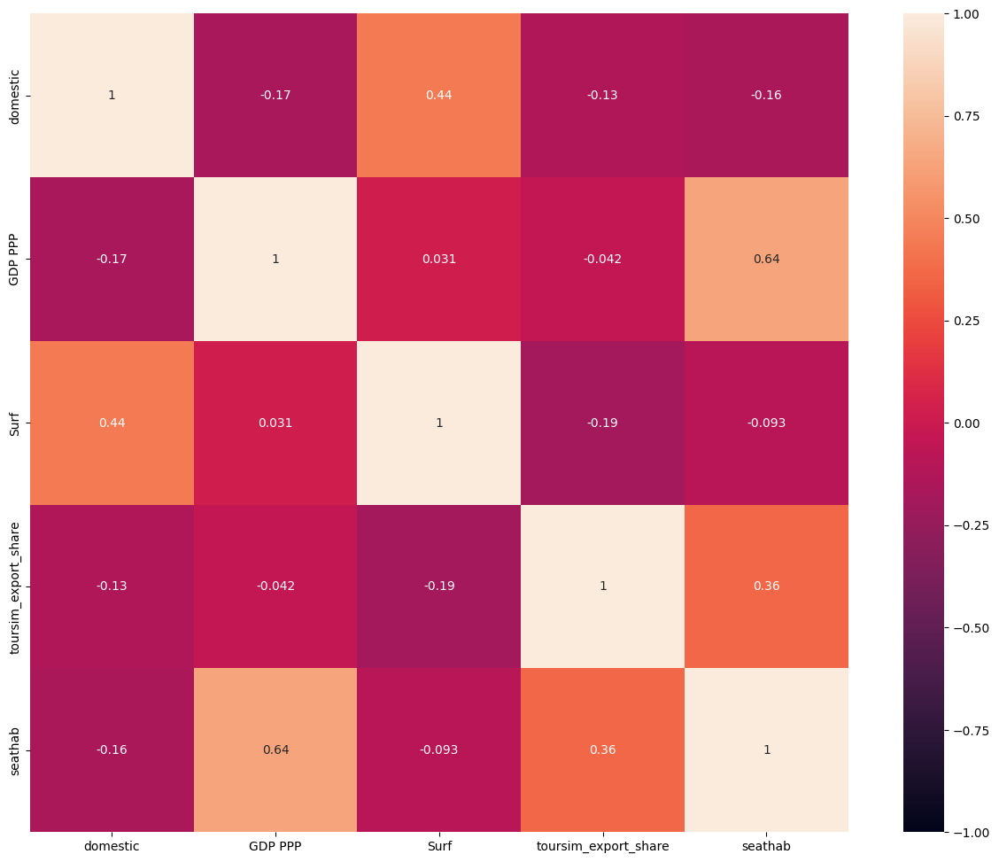

In [12]:
df = countries_fixed_test.copy()

# df= df[df.domestic==1]

df['seathab']=df['seats']/df['population']



df_heat = df.drop(columns=["departure_country","departure_country_name","departure_ISO3",'departure_lon','departure_lat', 'CO2 (Mt)', 'ASK (Bn)', 'Seats (Mn)','Gini', 'visiting_tourists',
                           'outbound_tourists', 'seats', 'ask', 'co2','fuel_burn','Notes', 'population'])
fig, ax = plt.subplots(figsize=(16,12))
ax = sns.heatmap(df_heat.corr(), annot=True, ax=ax, square=True, vmin=-1, vmax=1)

In [11]:
df.isna().sum()

departure_country           0
departure_country_name      0
departure_ISO3              0
seats                       0
ask                         0
fuel_burn                   0
co2                         0
CO2 (Mt)                    0
ASK (Bn)                    0
Seats (Mn)                  0
domestic                    0
departure_lat               1
departure_lon               1
GDP PPP                     0
Gini                       32
Surf                        0
toursim_export_share        0
visiting_tourists           3
outbound_tourists          68
population                  0
Notes                     174
seathab                     0
dtype: int64

In [12]:
## Scaling data for KNN
column = (df_heat.columns).to_list()
# column = column[]


from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data_train = df_heat[column]
data_train[column] = scaler.fit_transform(data_train)

data_train=data_train.dropna()

In [13]:
data_train

,domestic,GDP PPP,Surf,toursim_export_share,seathab
0,0.212720,0.581956,0.004335,0.101918,0.424204
1,0.081691,0.011059,0.039825,0.059985,0.001116
2,0.029380,0.182698,0.000026,0.893380,0.367247
4,0.016540,0.105851,0.001672,0.548702,0.036952
5,0.000000,0.111292,0.001737,0.288317,0.034200
...,...,...,...,...,...
224,0.392867,0.077993,0.019137,0.044954,0.033726
225,0.949614,0.019171,0.000743,0.852291,0.083774
227,0.148858,0.046002,0.000169,0.658875,0.074611
231,0.384979,0.107480,0.074072,0.091704,0.022622


In [42]:
from sklearn.cluster import KMeans

wcss=[]
for i in range(1, 20):
    kmeans = KMeans(n_clusters = i,n_init=50,  random_state = 40)
    kmeans.fit(data_train)
    wcss.append(kmeans.inertia_)

plt.figure(figsize=(12,8))
plt.plot(range(1, 20), wcss)
plt.scatter(range(1, 20), wcss)

plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

SyntaxError: positional argument follows keyword argument (1111925258.py, line 5)

In [62]:

kmeans = KMeans(n_clusters=5, n_init=50).fit(data_train)
labels = kmeans.labels_

country_data_with_label = df_heat.copy().dropna()
country_data_with_label["cluster"] = labels

data_clustering = data_train.copy()
data_clustering['country'] = df["departure_country"]
data_clustering['country_iso'] = df["departure_ISO3"]
data_clustering["cluster"] = labels



cluster_map = {
    0 : "A", 
    1 : "B", 
    2 : "C",
    3 : 'D',
    4 : 'E',
    5:'F',
    6:'G',
    # 7:'H',
}

data_clustering = data_clustering.replace({"cluster" : cluster_map})



In [63]:
print(sns.color_palette().as_hex())

['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']


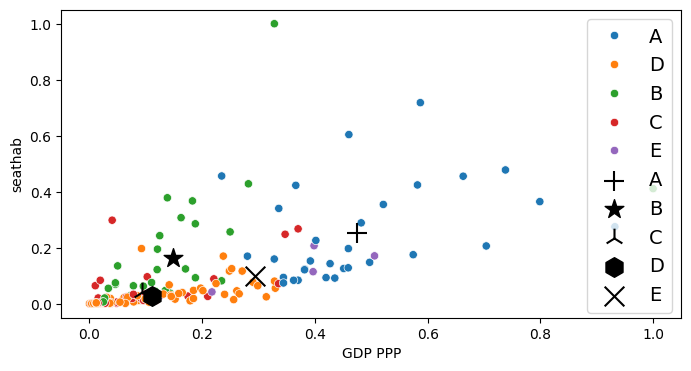

In [64]:
plt.figure(figsize=(8,4))
scat = sns.scatterplot(data=data_clustering, x="GDP PPP", y="seathab", hue="cluster")
# plt.suptitle('Clustering', y=0.95, weight="bold", fontsize=20)
# plt.title("aa", weight='light')

centers = kmeans.cluster_centers_
plt.scatter(centers[0,1], centers[0, 4],  s = 200, label='A', color='black', marker='+')
plt.scatter(centers[1,1], centers[1, 4],  s = 200, label='B', color='black', marker='*')
plt.scatter(centers[2,1], centers[2, 4],  s = 200, label='C', color='black', marker='2')
plt.scatter(centers[3,1], centers[3, 4],  s = 200, label='D', color='black', marker='h')
plt.scatter(centers[4,1], centers[4, 4],  s = 200, label='E', color='black', marker= 'x')
# plt.scatter(centers[5,1], centers[5, 4],  s = 200, label='F', color='black', marker='d')
# plt.scatter(centers[6,1], centers[6, 4],  s = 200, label='G', color='black', marker='P')
# plt.scatter(centers[7,1], centers[7, 4],  s = 200, label='H', color='black', marker= 'o')

scat.legend(fontsize=14)
plt.show()

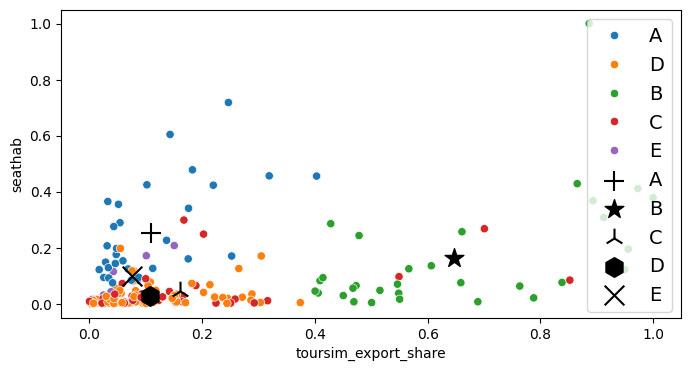

In [65]:
plt.figure(figsize=(8,4))
scat = sns.scatterplot(data=data_clustering, x="toursim_export_share", y="seathab", hue="cluster")
# plt.suptitle('Clustering', y=0.95, weight="bold", fontsize=20)
# plt.title("the lower the gdpp, the lower rate of life expectations", weight='light')

centers = kmeans.cluster_centers_
plt.scatter(centers[0,3], centers[0, 4],  s = 200, label='A', color='black', marker='+')
plt.scatter(centers[1,3], centers[1, 4],  s = 200, label='B', color='black', marker='*')
plt.scatter(centers[2,3], centers[2, 4],  s = 200, label='C', color='black', marker='2')
plt.scatter(centers[3,3], centers[3, 4],  s = 200, label='D', color='black', marker='h')
plt.scatter(centers[4,3], centers[4, 4],  s = 200, label='E', color='black', marker= 'x')
# plt.scatter(centers[5,3], centers[5, 4],  s = 200, label='F', color='black', marker='d')
# plt.scatter(centers[6,3], centers[6, 4],  s = 200, label='G', color='black', marker='P')
# plt.scatter(centers[7,3], centers[7, 4],  s = 200, label='H', color='black', marker= 'o')
scat.legend(fontsize=14)
plt.show()



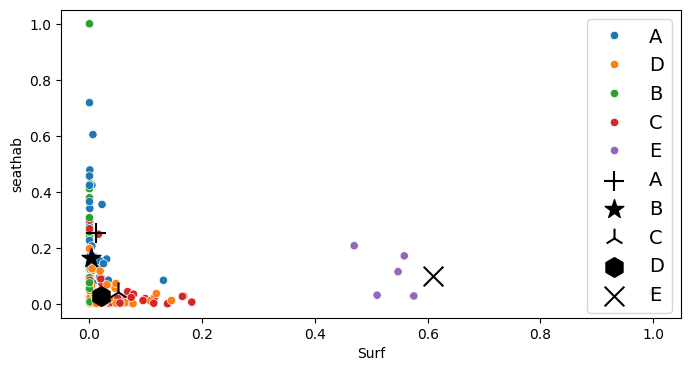

In [66]:
plt.figure(figsize=(8,4))
scat = sns.scatterplot(data=data_clustering, x="Surf", y="seathab", hue="cluster")
# plt.suptitle('Clustering', y=0.95, weight="bold", fontsize=20)
# plt.title("the lower the gdpp, the lower rate of life expectations", weight='light')

centers = kmeans.cluster_centers_
plt.scatter(centers[0,2], centers[0, 4],  s = 200, label='A', color='black', marker='+')
plt.scatter(centers[1,2], centers[1, 4],  s = 200, label='B', color='black', marker='*')
plt.scatter(centers[2,2], centers[2, 4],  s = 200, label='C', color='black', marker='2')
plt.scatter(centers[3,2], centers[3, 4],  s = 200, label='D', color='black', marker='h')
plt.scatter(centers[4,2], centers[4, 4],  s = 200, label='E', color='black', marker= 'x')
# plt.scatter(centers[5,2], centers[5, 4],  s = 200, label='F', color='black', marker='d')
# plt.scatter(centers[6,2], centers[6, 4],  s = 200, label='G', color='black', marker='P')
# plt.scatter(centers[7,2], centers[7, 4],  s = 200, label='H', color='black', marker= 'o')

scat.legend(fontsize=14)
plt.show()

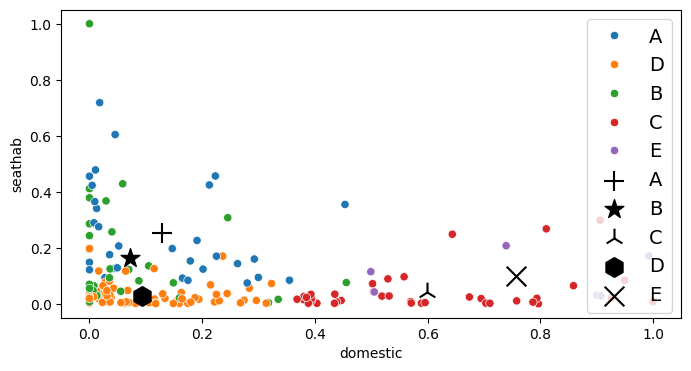

In [67]:
plt.figure(figsize=(8,4))
scat = sns.scatterplot(data=data_clustering, x="domestic", y="seathab", hue="cluster")
# plt.suptitle('Clustering', y=0.95, weight="bold", fontsize=20)
# plt.title("the lower the gdpp, the lower rate of life expectations", weight='light')

centers = kmeans.cluster_centers_
plt.scatter(centers[0,0], centers[0, 4],  s = 200, label='A', color='black', marker='+')
plt.scatter(centers[1,0], centers[1, 4],  s = 200, label='B', color='black', marker='*')
plt.scatter(centers[2,0], centers[2, 4],  s = 200, label='C', color='black', marker='2')
plt.scatter(centers[3,0], centers[3, 4],  s = 200, label='D', color='black', marker='h')
plt.scatter(centers[4,0], centers[4, 4],  s = 200, label='E', color='black', marker= 'x')
# plt.scatter(centers[5,0], centers[5, 4],  s = 200, label='F', color='black', marker='d')
# plt.scatter(centers[6,0], centers[6, 4],  s = 200, label='G', color='black', marker='P')
# plt.scatter(centers[7,0], centers[7, 4],  s = 200, label='H', color='black', marker= 'o')

scat.legend(fontsize=14)
plt.show()

Text(0.5, 0, '')

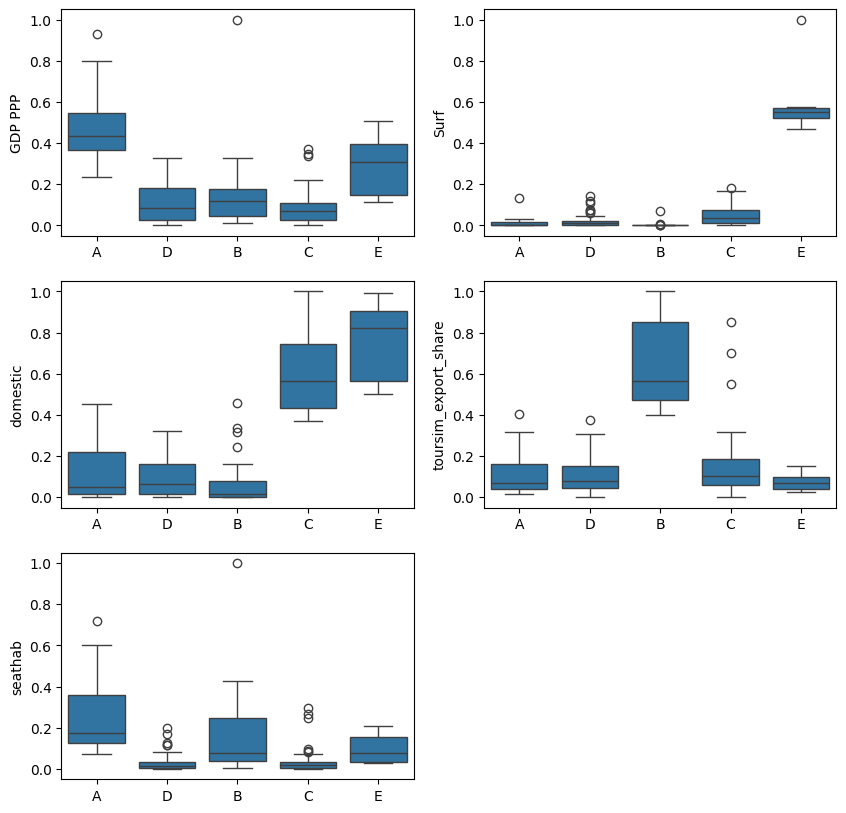

In [68]:
fig = plt.figure(figsize=(10,10))
child_mort = fig.add_subplot(3,2,1) # or fig.add_subplot(xyz)
exports = fig.add_subplot(3,2,2)
health = fig.add_subplot(3,2,3)
imports = fig.add_subplot(3,2,4)
income = fig.add_subplot(3,2,5)


#subplot 1
sns.boxplot(x='cluster', y='GDP PPP', data=data_clustering, ax=child_mort)
child_mort.set_xlabel('')

#subplot 2
sns.boxplot(x='cluster', y='Surf', data=data_clustering, ax=exports)
exports.set_xlabel('')

#subplot 3
sns.boxplot(x='cluster', y='domestic', data=data_clustering, ax=health)
health.set_xlabel('')

#subplot 4
sns.boxplot(x='cluster', y='toursim_export_share', data=data_clustering, ax=imports)
imports.set_xlabel('')

#subplot 5
sns.boxplot(x='cluster', y='seathab', data=data_clustering, ax=income)
income.set_xlabel('')


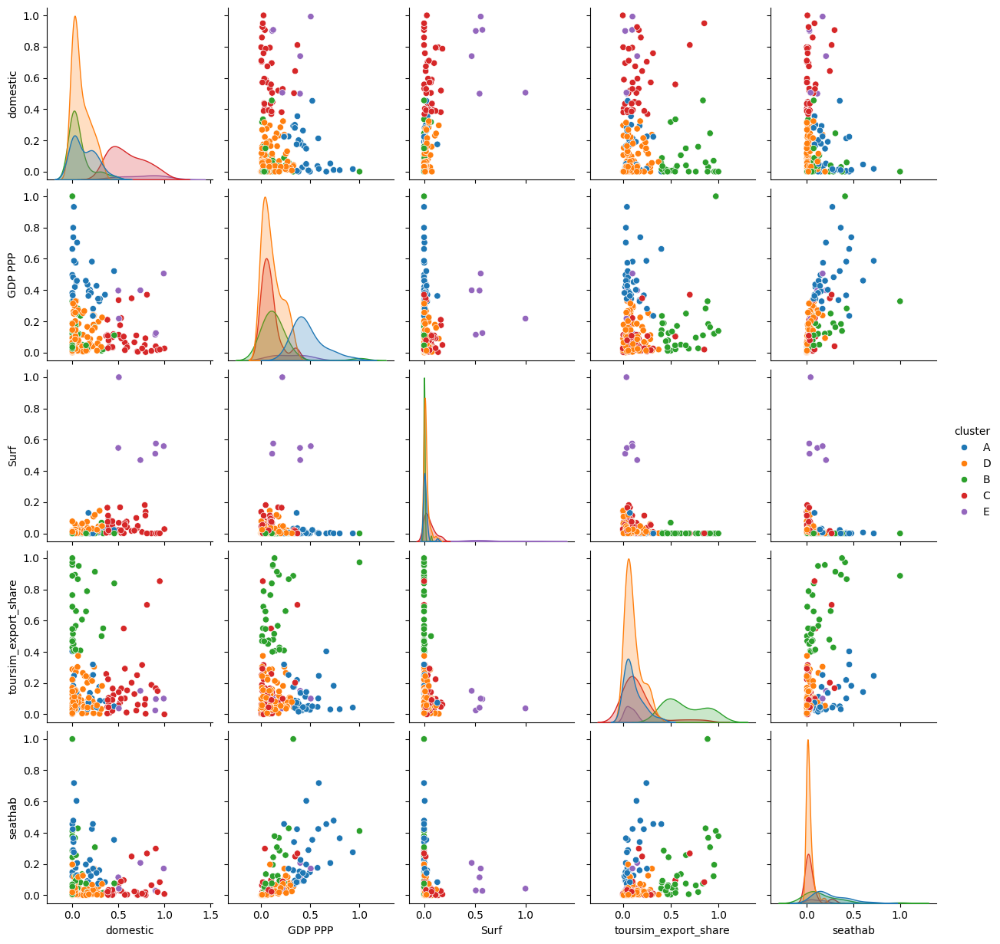

In [69]:

sns.pairplot(data_clustering, hue='cluster')
plt.show()



C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\miniconda3\envs\aeroscope\lib\site-packages\numpy\core\fromnumeric.py:3462: FutureWarning:

In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\miniconda3\envs\aeroscope\lib\site-packages\numpy\core\fromnumeric.py:3462: FutureWarning:

In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\miniconda3\envs\aeroscope\lib\site-packages\numpy\core\fromnumeric.py:3462: FutureWarning:

In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'

C:\Users\a.salgas.ISAE-SUPAERO\AppData\Local\miniconda3\en

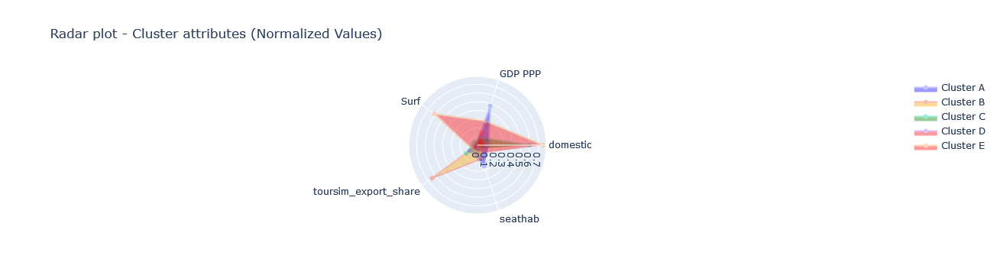

In [70]:
#cluster characteristics with a radarplot
import plotly.graph_objects as go

attributes = data_clustering.columns[:5]

fig = go.Figure()

fig.add_trace(go.Scatterpolar(r=np.mean(data_clustering.loc[data_clustering.cluster == 'A', attributes]),
                              theta=attributes,
                              fill='toself',
                              fillcolor='blue',
                              opacity=0.4,
                              name='Cluster A'))
fig.add_trace(go.Scatterpolar(r=np.mean(data_clustering.loc[data_clustering.cluster == 'B', attributes]),
                              theta=attributes,
                              fill='toself',
                              fillcolor='orange',
                              opacity=0.4,
                              name='Cluster B'))
fig.add_trace(go.Scatterpolar(r=np.mean(data_clustering.loc[data_clustering.cluster == 'C', attributes]),
                              theta=attributes,
                              fill='toself',
                              fillcolor='green',
                              opacity=0.4,
                              name='Cluster C'))
fig.add_trace(go.Scatterpolar(r=np.mean(data_clustering.loc[data_clustering.cluster == 'D', attributes]),
                              theta=attributes,
                              fill='toself',
                              fillcolor='red',
                              opacity=0.4,
                              name='Cluster D'))
fig.add_trace(go.Scatterpolar(r=np.mean(data_clustering.loc[data_clustering.cluster == 'E', attributes]),
                              theta=attributes,
                              fill='toself',
                              fillcolor='red',
                              opacity=0.4,
                              name='Cluster E'))

fig.update_layout(polar=dict(radialaxis=dict(visible=True)),showlegend=True,
                  title="Radar plot - Cluster attributes (Normalized Values)", height=800)
fig.show()

In [71]:
### Try with more clusters ==> Not conclusive.

In [72]:
import geopandas as gpd
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Join the data frame with the shapefile
gdf = world.merge(data_clustering, left_on='iso_a3', right_on='country_iso')
gdf.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry,domestic,GDP PPP,Surf,toursim_export_share,seathab,country,country_iso,cluster
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",0.558219,0.102477,0.001114,0.549196,0.096219,FJ,FJI,C
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982...",0.570964,0.015136,0.054087,0.292315,0.002427,TZ,TZA,C
2,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",0.499191,0.396764,0.547454,0.042355,0.114377,CA,CAN,E
3,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",0.992591,0.505753,0.558557,0.100882,0.170940,US,USA,E
4,18513930.0,Asia,Kazakhstan,KAZ,181665,"POLYGON ((87.35997 49.21498, 86.59878 48.54918...",0.380764,0.209859,0.164847,0.047326,0.026238,KZ,KAZ,C


In [73]:
fig = px.choropleth_mapbox(
    gdf,
    geojson=gdf.geometry,
    locations=gdf.index,
    color='cluster',
    mapbox_style="carto-positron",
    height=800
)

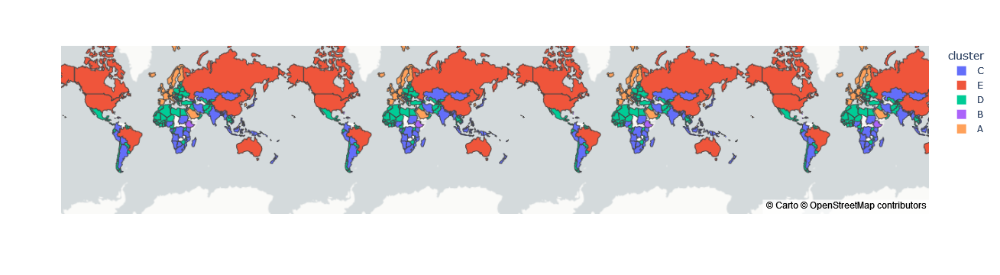

In [74]:
fig

In [75]:
data_clustering[data_clustering.cluster=='B']

,domestic,GDP PPP,Surf,toursim_export_share,seathab,country,country_iso,cluster
2,0.029380,0.182698,2.564596e-05,0.893380,0.367247,AG,ATG,B
4,0.016540,0.105851,1.671872e-03,0.548702,0.036952,AL,ALB,B
11,0.000000,0.328037,9.769889e-06,0.886534,1.000000,AW,ABW,B
14,0.000000,0.124702,2.503534e-05,0.478318,0.243097,BB,BRB,B
28,0.058967,0.282017,6.100074e-04,0.865399,0.428309,BS,BHS,B
47,0.105077,0.050007,2.448578e-04,0.606485,0.135162,CV,CPV,B
48,0.000000,0.187805,2.589020e-05,0.428091,0.285492,CW,CUW,B
55,0.000000,0.095549,4.457512e-05,0.763449,0.062595,DM,DMA,B
56,0.016035,0.142854,2.948675e-03,0.405812,0.037812,DO,DOM,B
64,0.317648,0.011893,6.891135e-02,0.500607,0.003558,ET,ETH,B


In [57]:
country_flows_clust=country_flows.merge(data_clustering, left_on='departure_country', right_on='country', how='left').rename(columns={'cluster':'departure_cluster'})
country_flows_clust=country_flows_clust.merge(data_clustering, left_on='arrival_country', right_on='country', how='left').rename(columns={'cluster':'arrival_cluster'})


In [58]:
country_flows_clust

,departure_country,arrival_country,departure_country_name,arrival_country_name,departure_ISO3,arrival_ISO3,seats,ask,fuel_burn,co2,CO2 (Mt),ASK (Bn),Seats (Mn),departure_lat,departure_lon,arrival_lat,arrival_lon,color,domestic_x,GDP PPP_x,Surf_x,toursim_export_share_x,seathab_x,country_x,country_iso_x,departure_cluster,domestic_y,GDP PPP_y,Surf_y,toursim_export_share_y,seathab_y,country_y,country_iso_y,arrival_cluster
0,AE,AE,United Arab Emirates,United Arab Emirates,ARE,ARE,3.773469e+06,2.292462e+06,7.107818e+05,2.246071e+06,0.002246,0.002292,3.773469,24.0,54.0,24.0,54.0,#7D00FF,0.212720,0.581956,0.004335,0.101918,0.424204,AE,ARE,A,0.212720,0.581956,0.004335,0.101918,0.424204,AE,ARE,A
1,AE,AF,United Arab Emirates,"Afghanistan, Islamic Republic of",ARE,AFG,4.824492e+05,8.111237e+08,1.943289e+07,6.140795e+07,0.061408,0.811124,0.482449,24.0,54.0,33.0,65.0,#7D00FF,0.212720,0.581956,0.004335,0.101918,0.424204,AE,ARE,A,0.081691,0.011059,0.039825,0.059985,0.001116,AF,AFG,D
2,AE,AL,United Arab Emirates,"Albania, Republic of",ARE,ALB,2.630364e+02,9.863667e+05,1.981434e+04,6.261332e+04,0.000063,0.000986,0.000263,24.0,54.0,41.0,20.0,#7D00FF,0.212720,0.581956,0.004335,0.101918,0.424204,AE,ARE,A,0.016540,0.105851,0.001672,0.548702,0.036952,AL,ALB,C
3,AE,AM,United Arab Emirates,"Armenia, Republic of",ARE,ARM,1.290026e+05,2.506020e+08,5.173337e+06,1.634774e+07,0.016348,0.250602,0.129003,24.0,54.0,40.0,45.0,#7D00FF,0.212720,0.581956,0.004335,0.101918,0.424204,AE,ARE,A,0.000000,0.111292,0.001737,0.288317,0.034200,AM,ARM,D
4,AE,AO,United Arab Emirates,"Angola, Republic of",ARE,AGO,1.172423e+05,6.944986e+08,1.634034e+07,5.163546e+07,0.051635,0.694499,0.117242,24.0,54.0,-12.5,18.5,#7D00FF,0.212720,0.581956,0.004335,0.101918,0.424204,AE,ARE,A,0.588891,0.048101,0.076125,0.011666,0.001839,AO,AGO,B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7519,ZW,RW,"Zimbabwe, Republic of","Rwanda, Republic of",ZWE,RWA,2.529389e+04,4.474041e+07,1.062685e+06,3.358084e+06,0.003358,0.044740,0.025294,-20.0,30.0,-2.0,30.0,#FF7D7D,0.267945,0.012071,0.023621,0.057867,0.003133,ZW,ZWE,D,0.055822,0.011972,0.001505,0.303422,0.003907,RW,RWA,D
7520,ZW,TZ,"Zimbabwe, Republic of","Tanzania, United Republic of",ZWE,TZA,2.295190e+04,3.458205e+07,8.460097e+05,2.673391e+06,0.002673,0.034582,0.022952,-20.0,30.0,-6.0,35.0,#FF7D7D,0.267945,0.012071,0.023621,0.057867,0.003133,ZW,ZWE,D,0.570964,0.015136,0.054087,0.292315,0.002427,TZ,TZA,B
7521,ZW,ZA,"Zimbabwe, Republic of","South Africa, Republic of",ZWE,ZAF,6.464164e+05,6.411850e+08,1.757866e+07,5.554856e+07,0.055549,0.641185,0.646416,-20.0,30.0,-29.0,24.0,#FF7D7D,0.267945,0.012071,0.023621,0.057867,0.003133,ZW,ZWE,D,0.384979,0.107480,0.074072,0.091704,0.022622,ZA,ZAF,B
7522,ZW,ZM,"Zimbabwe, Republic of","Zambia, Republic of",ZWE,ZMB,1.290411e+05,5.149301e+07,2.127921e+06,6.724231e+06,0.006724,0.051493,0.129041,-20.0,30.0,-15.0,30.0,#FF7D7D,0.267945,0.012071,0.023621,0.057867,0.003133,ZW,ZWE,D,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [59]:
hoss=country_flows_clust.groupby(['departure_cluster','arrival_cluster'])['ask'].sum().reset_index()

In [60]:
hoss.rename(columns={'departure_cluster':'source','arrival_cluster':'target','ask':'weight'},inplace=True)
hoss

,source,target,weight
0,A,A,1.262499e+12
1,A,B,4.496178e+11
2,A,C,7.548517e+10
3,A,D,4.646933e+11
4,A,E,7.616217e+11
5,B,A,4.496178e+11
6,B,B,6.334209e+11
7,B,C,1.777489e+10
8,B,D,1.056028e+11
9,B,E,2.705757e+11


In [61]:
from d3blocks import D3Blocks
d3=D3Blocks()

d3.chord(hoss)

[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [C:\Users\ASALGA~1.ISA\AppData\Local\Temp\d3blocks\chord.html]
[d3blocks] >INFO> Convert to DataFrame.
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Set edge-opacity based on the [source] node-opacity.
[d3blocks] >INFO> Set edge-colors based on the [source] node-color.
[d3blocks] >INFO> Edge properties are set.
[d3blocks] >INFO> File already exists and will be overwritten: [C:\Users\ASALGA~1.ISA\AppData\Local\Temp\d3blocks\chord.html]
[d3blocks] >INFO> Open browser: C:\Users\ASALGA~1.ISA\AppData\Local\Temp\d3blocks\chord.html


In [34]:
# tested insularity and biggest airport (hub proxy) ==> Not relevant

In [35]:
# ranked_airports = flights_df[(flights_df.distance_km>5000) & (flights_df.seats>100000)].groupby(['iata_departure','departure_country'])['iata_arrival'].count().sort_values(ascending=False).reset_index(name='destination_count').reset_index()

# first_airport_rank = ranked_airports.groupby('departure_country').head(1).reset_index(drop=True)

In [36]:
# country_rank_df = first_airport_rank[['departure_country', 'index']].reset_index(drop=True)
# country_rank_df.columns = ['country_code', 'airport_rank']

In [37]:
# df=df.merge(country_rank_df, left_on='departure_country', right_on='country_code', how='left')

In [38]:
# country_rank_df